In [ ]:
from notebooks import *
print_sys_info()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


The potoo.default_magic_magic extension is already loaded. To reload it, use:
  %reload_ext potoo.default_magic_magic
platform:
  machine: x86_64
  node: Dan-B.local
  processor: i386
  release: 15.6.0
  system: Darwin
  version: 'Darwin Kernel Version 15.6.0: Thu Jun 23 18:25:34 PDT 2016; root:xnu-3248.60.10~1/RELEASE_X86_64'
cpu: 8
mem: 16g
swap: 15g


In [ ]:
# Load model
#   - Chosen via notebooks/20180629_eval.ipynb (local runs) -> Train/test scores
search = Search.load_v0(

    # 'eval-na-dan170',
    #     'split_i=0,train=2693,test=674,classes=170', 'n_species=170,n_recs=1.0',
    #         'cls=logreg_ovr,solver=liblinear,C=0.1,class_weight=balanced',  # Not std
    #         'cls=std-sgdlog,alpha=0.1,class_weight=balanced',  # std [Re-run locally to get an n_species=170]

    'comp-l1-l2-na-ca',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=9,n_recs=1.0',
        #     'cls=logreg_ovr,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=logreg_ovr_l1,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=1,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=1,class_weight=balanced',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=82,n_recs=1.0',
        #     'cls=logreg_ovr,solver=liblinear,C=0.1,class_weight=balanced',
        #     'cls=logreg_ovr_l1,solver=liblinear,C=0.3,class_weight=balanced',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=0.01,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=0.1,class_weight=balanced',

        # 'split_i=0,train=28164,test=7042,classes=331', 'n_species=331,n_recs=1.0',
        #     'cls=ovr-logreg_ovr,solver=liblinear,C=0.01,class_weight=balanced',
        #     'cls=ovr-logreg_ovr_l1,solver=liblinear,C=0.001,class_weight=balanced',

        'split_i=0,train=34875,test=331,classes=331', 'n_species=331,n_recs=1.0',
            'cls=ovr-logreg_ovr,solver=liblinear,C=0.001,class_weight=balanced',

).fix_missing_projection_skm(
    'peterson-v0-26bae1c',
)
projection = search.projection
features = projection.features
load = features.load
display(
    search,
    search.classifier_,
    len(search.classifier_.classes_),
)

[00:07:33.679] DEBUG  Projection.load
  path: /Users/danb/hack/bubo/features/data/models/projection/peterson-v0-26bae1c.pkl


Search(
  n_species=331,
  n_recs=1.0,
  classifier='cls: ovr-logreg_ovr,solver: liblinear,C: 0.001,class_weight: balanced',
  random_state=0,
  projection=Projection(
    features=Features(
      load=Load(channels=1, sample_rate=22050, sample_width_bit=16, cache_audio=True),
      sample_rate=22050,
      f_min=1000,
      f_bins=40,
      hop_length=256,
      frame_length=512,
      frame_window='hann',
      patch_length=4
    ),
    skm_fit_max_t=600000,
    k=500,
    variance_explained=0.99,
    do_pca=True,
    pca_whiten=True,
    standardize=False,
    normalize=False,
    agg_funs=['mean', 'std', 'max']
  )
)

OneVsRestClassifier(estimator=LogisticRegression(C=0.001, class_weight='balanced', dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=1, penalty='l2', random_state=0,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False),
          n_jobs=45)

331

# Load user recs

In [ ]:
user_recs = load_app_recs(projection,
    # n=10,
)
display(
    df_summary(user_recs).T,
    df_value_counts(user_recs, dropna=False),
    user_recs[:10],
)

[00:07:33.759] DEBUG  Load.audio:in
  len(recs): 169
  len(recs) per dataset: {recordings: 169}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[##########                                                                                ] | 11% Completed |  0.2s

[##################################################                                        ] | 55% Completed |  0.4s

[##########################################################################################] | 100% Completed |  0.5s

[00:07:34.282] DEBUG  Load.audio:out
  len(audio): 169


[00:07:35.611] WARN   Dropped 1 recs with duplicate audio_id


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat
audio_id,,,,,,,,,,,,,,,
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2.wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot) 2: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...
20171007-c6f4,2017-10-07 15:18:04,recordings,BEWR,Bewick's Wren,BEWR,30.3,1.28,668860,BEWR Bewicks Wren 2 (Coyote Hills parking lot),Bewick's Wren - BEWR,c6f4dae698ffb4a89fc86f16534acc42cd22ffa9,recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot),recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot).wav,"box(unbox=recordings/BEWR Bewicks Wren 2 (Coyote Hills parking lot): 1 channels, 16 bit, sampled @ 22.05 kHz, 30.334s long)",[ 4.983e-02 -9.263e-03 -5.601e-02 -3.380e-02 1.946e-02 9.371e-02 2.812e-02 -1.783e-02 8.781e-02 -8.130e-02\n -2.813e-02 -4.650e-02 -4.735e-02 -7.861e-02 -5.890e-02 1.4...


[00:07:35.660] DEBUG  Features.spectros:in
  len(recs): 168
  len(recs) per dataset: {recordings: 168}
  sum(duration_h): 3.4
  sum(samples_mb): 514.0
  sum(samples_n): 269716306
[                                                                                          ] | 0% Completed |  0.0s

[######                                                                                    ] | 7% Completed |  0.1s

[###############################                                                           ] | 35% Completed |  0.2s

[####################################################                                      ] | 58% Completed |  0.3s

[######################################################################                    ] | 77% Completed |  0.4s

[##########################################################################################] | 100% Completed |  0.5s

[00:07:36.210] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 1053337]


,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
audio_id,object,11760,168,168,168.0,NaN,NaN,20160709-1e8c,20160910-827a,20171007-c6f4,20180519-486a,20180826-e354
recorded_at,datetime64[ns],1344,168,168,168.0,NaN,NaN,2016-07-09 18:38:51,2016-09-10 21:58:34,2017-10-07 15:20:39,2018-05-19 06:39:18,2018-08-26 17:08:16
dataset,object,11256,168,168,1.0,NaN,NaN,recordings,recordings,recordings,recordings,recordings
species,object,10248,168,168,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
species_com_name,object,11258,168,168,35.0,NaN,NaN,American Bittern,Red-tailed Hawk,Unknown,Unknown,Wilson's Warbler
species_query,object,10248,168,168,35.0,NaN,NaN,AMBI,RTHA,_UNK,_UNK,_UNK
duration_s,float64,1344,168,168,163.0,NaN,NaN,2.75,19.3,50.9,90.8,691
samples_mb,float64,1344,168,168,163.0,NaN,NaN,0.115,0.81,2.14,3.82,29
samples_n,int64,1344,168,168,163.0,NaN,NaN,60544,424696,1122375,2002707,15229220


,dataset,n,species,n,species_com_name,n,species_query,n,duration_s,n,samples_mb,n,samples_n,n,species_longhand,n
0,recordings,168,_UNK,108,Unknown,108,_UNK,108,3.85,2,0.166,2,84480,2,Unknown - _UNK,108
1,,,RTHA,4,Red-tailed Hawk,4,RTHA,4,4.94,2,0.208,2,108928,2,Common Raven - CORA,4
2,,,CORA,4,Common Raven,4,CORA,4,3.83,2,0.162,2,86784,2,Red-tailed Hawk - RTHA,4
3,,,WCSP,3,Bewick's Wren,3,WCSP,3,3.94,2,0.297,2,155776,2,Bewick's Wren - BEWR,3
4,,,SOSP,3,Orange-crowned Warbler,3,SOSP,3,7.06,2,0.161,2,84864,2,Song Sparrow - SOSP,3
5,,,OCWA,3,White-crowned Sparrow,3,OCWA,3,162.00,1,0.147,1,224562,1,Spotted Towhee - SPTO,3
6,,,WIWA,3,Song Sparrow,3,WIWA,3,29.80,1,0.247,1,199168,1,Wilson's Warbler - WIWA,3
7,,,BEWR,3,Wilson's Warbler,3,BEWR,3,56.40,1,0.185,1,2044677,1,Orange-crowned Warbler - OCWA,3
8,,,SPTO,3,Spotted Towhee,3,SPTO,3,88.20,1,0.159,1,95232,1,White-crowned Sparrow - WCSP,3
9,,,MAWR,2,California Scrub-Jay,2,MAWR,2,59.90,1,5.800,1,2766599,1,Fox Sparrow - FOSP,2


,recorded_at,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,audio_sha,id,path,audio,feat,spectro
audio_id,,,,,,,,,,,,,,,,
20160709-1e8c,2016-07-09 19:04:03,recordings,CALT,California Towhee,CALT,43.2,1.820,951746,CALT cal towhee,California Towhee - CALT,1e8c9cfe8f48560aa30173bb9f20aee30e7ecd71,recordings/CALT cal towhee,recordings/CALT cal towhee.wav,"box(unbox=recordings/CALT cal towhee: 1 channels, 16 bit, sampled @ 22.05 kHz, 43.163s long)",[ 2.035e-03 6.529e-02 2.609e-01 -8.920e-02 7.727e-02 2.055e-01 2.770e-02 -5.686e-02 4.625e-01 -4.459e-02\n -2.317e-01 1.583e-01 -7.546e-03 -1.656e-01 2.748e-02 -1.4...,
20160709-228d,2016-07-09 20:51:51,recordings,RTHA,Red-tailed Hawk,RTHA,42.1,1.770,928934,"RTHA red tailed hawk, noise",Red-tailed Hawk - RTHA,228d2414340927d1c8193963959bb82a6681e6db,"recordings/RTHA red tailed hawk, noise","recordings/RTHA red tailed hawk, noise.wav","box(unbox=recordings/RTHA red tailed hawk, noise: 1 channels, 16 bit, sampled @ 22.05 kHz, 42.129s long)",[ 1.452e-01 -3.292e-02 6.948e-01 -2.057e-02 -1.251e-02 -2.576e-02 4.741e-02 -4.145e-01 1.621e-01 -1.482e-01\n -1.505e-01 1.070e-01 -3.720e-02 -8.035e-02 -5.857e-03 1.3...,
20160709-4bb7,2016-07-09 19:57:52,recordings,_UNK,Unknown,_UNK,59.9,2.520,1320202,Recording 0019,Unknown - _UNK,4bb7924a5092f24d2fede40c339479b1befb6ac0,recordings/Recording 0019,recordings/Recording 0019.wav,"box(unbox=recordings/Recording 0019: 1 channels, 16 bit, sampled @ 22.05 kHz, 59.873s long)",[ 4.733e-02 2.485e-02 1.041e-01 -2.679e-02 2.001e-02 3.011e-03 9.353e-02 -1.986e-02 9.155e-02 -9.730e-02\n -2.053e-01 3.033e-01 -8.698e-03 -9.605e-02 9.715e-02 1.5...,
20160709-4e73,2016-07-09 19:07:43,recordings,WCSP,White-crowned Sparrow,WCSP,21.9,0.923,483910,WCSP white crowned,White-crowned Sparrow - WCSP,4e73e2c74b271647b5406c5784b8af1fd609b8eb,recordings/WCSP white crowned,recordings/WCSP white crowned.wav,"box(unbox=recordings/WCSP white crowned: 1 channels, 16 bit, sampled @ 22.05 kHz, 21.946s long)",[ 2.455e-02 -1.062e-02 9.811e-01 -9.299e-02 4.945e-02 -5.597e-02 5.669e-02 -2.279e-01 4.159e-01 -7.791e-02\n -1.896e-01 1.582e-01 -4.445e-02 -9.104e-02 6.175e-02 -1.1...,
20160709-59d3,2016-07-09 18:53:03,recordings,RTHA,Red-tailed Hawk,RTHA,30.6,1.290,674360,RTHA red tailed hawk,Red-tailed Hawk - RTHA,59d360c416f841fdc19213c1943c73b39992e241,recordings/RTHA red tailed hawk,recordings/RTHA red tailed hawk.wav,"box(unbox=recordings/RTHA red tailed hawk: 1 channels, 16 bit, sampled @ 22.05 kHz, 30.583s long)",[ 2.229e-02 -1.745e-02 7.496e-01 -5.046e-02 -3.577e-02 -4.409e-02 2.941e-04 -2.590e-01 2.597e-01 2.174e-02\n -1.398e-01 -4.891e-02 -5.807e-03 -9.787e-02 -1.195e-01 -1.8...,
20160709-795e,2016-07-09 20:34:26,recordings,_UNK,Unknown,_UNK,71.2,2.990,1569411,unknown sparrow (song?),Unknown - _UNK,795e65fdd0566f69ddfaa13bae28c5e6fde0d3f6,recordings/unknown sparrow (song?),recordings/unknown sparrow (song?).wav,"box(unbox=recordings/unknown sparrow (song?): 1 channels, 16 bit, sampled @ 22.05 kHz, 71.175s long)",[ 1.549e-01 -4.838e-02 1.737e-01 2.306e-02 3.237e-04 -4.025e-02 1.242e-01 -8.359e-02 2.388e-01 -9.303e-02\n -2.223e-01 2.008e-02 -1.347e-01 -4.654e-02 -5.248e-02 3.6...,
20160709-81dc,2016-07-09 20:59:19,recordings,HAWO,Hairy Woodpecker,HAWO,59.3,2.490,1307828,HAWO hairy woodpecker (2),Hairy Woodpecker - HAWO,81dc45758f7932931a1072df74422793bb083cda,recordings/HAWO hairy woodpecker (2),recordings/HAWO hairy woodpecker (2).wav,"box(unbox=recordings/HAWO hairy woodpecker (2): 1 channels, 16 bit, sampled @ 22.05 kHz, 59.312s long)",[ 6.210e-02 -3.008e-02 9.021e-03 -5.638e-02 1.596e-02 -4.143e-02 6.790e-02 -2.643e-02 1.448e-01 -8.180e-02\n -9.243e-02 1.103e-01 -3.034e-02 -3.102e-02 6.833e-02 -1.6...,
20160709-8c26,2016-07-09 19:51:42,recordings,_UNK,Unknown,_UNK,72.1,3.030,1589856,Recording 0018,Unknown - _UNK,8c26390858462d8ccfad92be14e1758014f54c12,recordings/Recording 0018,recordings/Recording 0018.wav,"box(unbox=recording

# Load xc recs

In [ ]:
# Load xc_recs
#   1. countries: Filter recs to these countries
#   2. species: Filter recs to these species
#   3. recs_at_least: Filter species to those with at least this many recs
#   4. num_species: Sample this many of the species
#   5. num_recs: Sample this many recs per species
inf = np.inf
# countries_k, com_names_k = 'na', 'us'      # 9.4k/400k -> 1.1k/60k -> 774/53k
# countries_k, com_names_k = 'na', 'ca'      # 9.4k/400k -> 1.1k/60k -> 334/35k
# countries_k, com_names_k = 'na', 'dan170'  # 9.4k/400k -> 1.1k/60k -> 170/3.4k
# countries_k, com_names_k = 'na', 'dan4'    # 9.4k/400k -> 1.1k/60k ->   4/2.2k (BEWR, HOWR, SOSP, SPTO)
countries_k, com_names_k = 'na', 'dan5'    # 9.4k/400k -> 1.1k/60k ->   5/2.3k (BEWR, HOWR, SOSP, SPTO, PSFL)
recs_at_least, num_species, num_recs =   0, inf, inf  # US[334/35k ->1.1k/60k -> 774/53k -> 774/53k   -> 743/53k]    # All US
# recs_at_least, num_species, num_recs = 100, 100, 100  # CA[334/35k -> 127/25k -> 100/21k -> 100/10k   -> 100/10k]
# recs_at_least, num_species, num_recs =  50, 100, 100  # CA[334/35k -> 224/32k -> 100/16k -> 100/ 9.0k -> 100/ 9.0k]
# recs_at_least, num_species, num_recs =   0, 100, 100  # CA[334/35k -> 334/35k -> 100/12k -> 100/ 6.8k ->  99/ 6.8k]
# recs_at_least, num_species, num_recs =   0, 168, 100  # CA[334/34k -> 334/34k -> 168/18k -> 168/11k   -> 167/11k]
# recs_at_least, num_species, num_recs =   0, 168,  20  # CA[334/34k -> 334/35k -> 168/18k -> 168/ 3.2k -> 167/ 3.2k]
# recs_at_least, num_species, num_recs =  20, 168,  20  # CA[334/35k -> 296/35k -> 168/20k -> 168/ 3.4k -> 168/ 3.4k]
# recs_at_least, num_species, num_recs =   0, inf,  20  # dan170 for app_brainstorm_1
# recs_at_least, num_species, num_recs =  20, 50,    5  # Faster dev
from datasets import *
xc_recs, recs_stats = load_xc_recs(projection, countries_k, com_names_k, recs_at_least, num_species, num_recs)

[00:07:36.796] INFO   [1/3 fast] Filtering xc.metadata -> xc_meta...
  (countries_k, com_names_k): [na, dan5]
  (recs_at_least, num_species, num_recs): [0, .inf, .inf]


all              9442/399859 (sp/recs)
countries         1148/59713 (sp/recs)
species               5/2340 (sp/recs)
(downloaded)          5/2340 (sp/recs)
recs_at_least         5/2340 (sp/recs)
num_species           5/2340 (sp/recs)
num_recs              5/2340 (sp/recs)
recs ≥ 2              5/2340 (sp/recs)
[00:07:41.696] INFO   [2/3 slower] Loading xc_meta -> xc_raw_recs (.audio, more metadata)...


[00:07:43.056] INFO   Inspect xc_raw_recs


,,,,,,,,min,25%,50%,75%,max
,dtype,sizeof,len,count,nunique,mean,std,,,,,
xc_id,int64,18720,2340,2340,2340.0,2.095e+05,1.086e+05,1211,126762,179087,309650,417352
dataset,object,138060,2340,2340,1.0,NaN,NaN,xc,xc,xc,xc,xc
species,category,2805,2340,2340,5.0,NaN,NaN,PSFL,HOWR,BEWR,SOSP,SPTO
species_com_name,category,2858,2340,2340,5.0,NaN,NaN,Pacific-slope Flycatcher,House Wren,Bewick's Wren,Song Sparrow,Spotted Towhee
species_query,object,142740,2340,2340,5.0,NaN,NaN,BEWR,HOWR,PSFL,SOSP,SPTO
duration_s,float64,18720,2340,2340,2149.0,5.267e+01,6.243e+01,1.01,18.4,36.3,65.4,1.07e+03
samples_mb,float64,18720,2340,2340,2149.0,2.219e+00,2.627e+00,0.0424,0.774,1.53,2.76,44.9
samples_n,int64,18720,2340,2340,2149.0,1.163e+06,1.377e+06,22226,405720,800640,1445774,23533524
basename,object,145080,2340,2340,1.0,NaN,NaN,audio,audio,audio,audio,audio


,species,n,subspecies,n,country,n,state,n,quality,n,type,n,(duration_s//30)*30,n,recordist,n,year,n,month,n,hour,n,place,n,n_background_species,n,bird_seen,n,playback_used,n,elevation,n,volume,n,speed,n,pitch,n,length,n,number_of_notes,n,variable,n,channels,n,sampling_rate,n,bitrate_of_mp3,n
0,SOSP,648,,1550,United States,1.51e+03,"California, United States",337,A,884,song,1199,0,977,Ian Cruickshank,324,2.02e+03,44,1,51,8,410,"Swan Lake, Victoria, Vancouver Island, BC, Canada",103,0,1.28e+03,yes,1.09e+03,no,1.73e+03,m,288,Not specified,1.33e+03,Not specified,1.35e+03,Not specified,1.35e+03,Not specified,1.29e+03,Not specified,1.34e+03,Not specified,1.36e+03,1 (mono),1.46e+03,44100 (Hz),1.47e+03,128000 (bps),1381
1,BEWR,522,montanus,95,Canada,485,"BC, Canada",281,B,983,call,516,30,695,Richard E. Webster,280,2.02e+03,158,2,128,7,329,"Rocky Point Bird Observatory, Metchosin, Vancouver Island, BC, Canada",54,1,382,,899,,549,10 m,85,level,606,level,634,both,412,0-3(s),885,7-20,436,no,736,2 (stereo),876,48000 (Hz),790,320000 (bps),283
2,SPTO,521,parkmanii,77,Mexico,345,"Arizona, United States",255,C,338,"call, song",119,60,324,Richard E Webster,150,2.02e+03,228,3,224,9,318,"San Bernardino National Wildlife Refuge, Cochise County, Arizona, United States",52,2,253,no,354,yes,65,0 m,84,both,248,both,228,level,400,3-6(s),98,1-3,301,yes,248,,,22050 (Hz),59,96000 (bps),223
3,HOWR,476,fallax,60,,,"Colorado, United States",111,D,50,Song,57,90,143,Thomas G. Graves,88,2.02e+03,311,4,297,10,264,"La Corona Arriba, Sierra San Pedro Martir, Baja California, Mexico",40,3,177,,,,,? m,80,increasing,97,accelerating,126,increasing,143,>10(s),44,>20,152,,,,,32000 (Hz),21,192000 (bps),145
4,PSFL,173,eremophilus,46,,,"British Columbia, Canada",74,E,12,"male, song",52,120,85,Manuel Grosselet,88,2.01e+03,233,5,465,,195,"Portal, Arizona, United States",31,4,110,,,,,100 m,71,decreasing,59,decelerating,6,decreasing,36,6-10(s),19,4-6,113,,,,,24000 (Hz),2,160000 (bps),63
5,,,melodia,36,,,"Baja California, Mexico",71,no score,73,alarm call,38,150,50,Frank Lambert,66,2.01e+03,309,6,479,6,191,"Hunter Mountain, Death Valley National Park, Inyo County, United States",30,5,62,,,,,1100 m,69,,,,,,,,,,,,,,,16000 (Hz),2,256000 (bps),30
6,,,megalonyx,34,,,"Texas, United States",55,,,contact calls,15,180,15,Paul Marvin,63,2.01e+03,340,7,238,11,138,"Lundbreck Falls, AB, Canada",23,6,33,,,,,2000 m,65,,,,,,,,,,,,,,,,,80000 (bps),14
7,,,falcinellus,33,,,"Inyo County, United States",45,,,Call,14,210,17,Mike Nelson,60,2.01e+03,146,8,178,12,88,"Bill Williams River NWR, Arizona, United States",20,7,14,,,,,1400 m,64,,,,,,,,,,,,,,,,,64000 (bps),8
8,,,difficilis,32,,,"New York, United States",40,,,male position note,12,240,10,Peter Boesman,58,2.01e+03,60,9,97,5,83,"Pedder Bay, Metchosin, Vancouver Island, BC, Canada",19,8,13,,,,,1500 m,61,,,,,,,,,,,,,,,,,48000 (bps),4
9,,,oregonus,29,,,"Pennsylvania, United States",37,,,"female, song",12,270,7,Eric DeFonso,44,2.01e+03,59,10,71,17,51,"Observatorio area, Sierra San Pedro Martir, Baja California, Mexico",18,9,6,,,,,1700 m,60,,,,,,,,,,,,,,,,,129316 (bps),3


,dataset,species,species_com_name,species_query,duration_s,samples_mb,samples_n,basename,species_longhand,id,path,downloaded,subspecies,recordist,country,locality,lat,lng,type,quality,date,time,license_type,license_detail,license,url,download,remarks,bird_seen,playback_used,elevation,background,volume,speed,pitch,length,number_of_notes,variable,channels,sampling_rate,bitrate_of_mp3,state_only,place_only,state,place,year,month,month_day,hour,background_species,n_background_species
xc_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
348150,xc,PSFL,Pacific-slope Flycatcher,PSFL,54.00,2.270,1190016,audio,Pacific-slope Flycatcher - PSFL,xc/data/PSFL/348150/audio,xc/data/PSFL/348150/audio.mp3,True,cineritius,Richard E. Webster,Mexico,"La Corona Arriba, Sierra San Pedro Martir, Baja California",31.0,-116.0,male position note,A,2001-06-15 00:00:00,06:25,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/348150,//www.xeno-canto.org/348150/download,"territory No 2, 1st recording",yes,no,2300 m,"['Pine Siskin (Spinus pinus)', 'Violet-green Swallow (Tachycineta thalassina)']",level,level,increasing,0-3(s),1-3,no,1 (mono),44100 (Hz),128000 (bps),Baja California,"La Corona Arriba, Sierra San Pedro Martir","Baja California, Mexico","La Corona Arriba, Sierra San Pedro Martir, Baja California, Mexico",2001,6,06-15,6.0,"['PISI', 'VGSW']",2
134864,xc,HOWR,House Wren,HOWR,108.00,4.530,2373991,audio,House Wren - HOWR,xc/data/HOWR/134864/audio,xc/data/HOWR/134864/audio.mp3,True,,Jonathon Jongsma,United States,"Grey Cloud Dunes SNA, Washington, Minnesota",44.8,-93.0,song,A,2013-05-25 00:00:00,5:51,by-sa,3.0,//creativecommons.org/licenses/by-sa/3.0/,https://www.xeno-canto.org/134864,//www.xeno-canto.org/134864/download,,yes,no,220 m,"['Northern Cardinal (Cardinalis cardinalis)', 'American Crow (Corvus brachyrhynchos)', 'Rose-breasted Grosbeak (Pheucticus ludovicianus)', 'American Goldfinch (Spinus trist...",Not specified,Not specified,Not specified,Not specified,Not specified,Not specified,1 (mono),48000 (Hz),192000 (bps),Minnesota,"Grey Cloud Dunes SNA, Washington","Minnesota, United States","Grey Cloud Dunes SNA, Washington, Minnesota, United States",2013,5,05-25,5.0,"['NOCA', 'AMCR', 'RBGR', 'AMGO', 'EATO']",5
373040,xc,HOWR,House Wren,HOWR,41.10,1.730,907200,audio,House Wren - HOWR,xc/data/HOWR/373040/audio,xc/data/HOWR/373040/audio.mp3,True,,Vicki Dern,United States,"Sunny Flat Campground, Cave Creek Canyon, Chiricahua Mountains, Cochise County, Arizona",31.9,-109.0,call,B,2017-05-14 00:00:00,05:35,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/373040,//www.xeno-canto.org/373040/download,Bird was moving about in low mesquite thicket and flying over to nest cavity in Sycamore.,yes,no,1600 m,['Common Raven'],Not specified,Not specified,Not specified,Not specified,Not specified,Not specified,2 (stereo),44100 (Hz),160000 (bps),Arizona,"Sunny Flat Campground, Cave Creek Canyon, Chiricahua Mountains, Cochise County","Arizona, United States","Sunny Flat Campground, Cave Creek Canyon, Chiricahua Mountains, Cochise County, Arizona, United States",2017,5,05-14,5.0,['Common Raven'],1
217852,xc,BEWR,Bewick's Wren,BEWR,75.70,3.180,1669626,audio,Bewick's Wren - BEWR,xc/data/BEWR/217852/audio,xc/data/BEWR/217852/audio.mp3,True,,Paul Marvin,United States,"Laguna Meadows Trail, Big Bend National Park, Brewster Co., Texas",29.3,-103.0,song,B,2012-04-07 00:00:00,10:45,by-nc-sa,4.0,//creativecommons.org/licenses/by-nc-sa/4.0/,https://www.xeno-canto.org/217852,//www.xeno-canto.org/217852/download,,None,no,2000 m,[],Not specified,Not specified,Not specified,Not specified,Not specified,Not specified,1 (mono),48000 (Hz),128000 (bps),Texas,"Laguna Meadows Trail, Big Bend National Park, Brewster Co.","Texas, United States","Laguna Meadows Trail, Big Bend National Park, Brewster Co., Texas, United States",2012,4,04-07,10.0,[],0
217823,xc,BEWR,Bewick's Wren,BEWR,9.24,0.389,203742,audio,Bewick's Wr

[00:07:43.811] INFO   Inspect xc_raw_recs: species counts (cheap plot)


,species_longhand,num_recs
0,Pacific-slope Flycatcher - PSFL,•••••••••••••••• /648
1,House Wren - HOWR,•••••••••••••••••••••••••••••••••••••••••••• /648
2,Bewick's Wren - BEWR,•••••••••••••••••••••••••••••••••••••••••••••••• /648
3,Song Sparrow - SOSP,•••••••••••••••••••••••••••••••••••••••••••••••••••••••••••• /648
4,Spotted Towhee - SPTO,•••••••••••••••••••••••••••••••••••••••••••••••• /648


[00:07:43.822] INFO   [3/3 slowest] Featurizing xc_raw_recs -> xc_recs (.audio, .feat, .spectro)...
[00:07:43.826] DEBUG  Load.audio:in
  len(recs): 2340
  len(recs) per dataset: {xc: 2340}
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[#####                                                                                     ] | 5% Completed |  0.3s

[######                                                                                    ] | 7% Completed |  0.5s

[##########                                                                                ] | 12% Completed |  0.6s

[#############                                                                             ] | 14% Completed |  0.7s

[################                                                                          ] | 18% Completed |  0.8s

[##################                                                                        ] | 20% Completed |  0.9s

[##################                                                                        ] | 20% Completed |  1.0s

[######################                                                                    ] | 25% Completed |  1.2s

[########################                                                                  ] | 27% Completed |  1.3s

[###########################                                                               ] | 30% Completed |  1.4s

[#############################                                                             ] | 32% Completed |  1.5s

[#################################                                                         ] | 36% Completed |  1.7s

[###################################                                                       ] | 39% Completed |  1.8s

[######################################                                                    ] | 43% Completed |  1.9s

[#########################################                                                 ] | 45% Completed |  2.0s

[##########################################                                                ] | 47% Completed |  2.2s

[##############################################                                            ] | 51% Completed |  2.3s

[################################################                                          ] | 53% Completed |  2.4s

[#################################################                                         ] | 54% Completed |  2.6s

[####################################################                                      ] | 57% Completed |  2.7s

[######################################################                                    ] | 60% Completed |  2.8s

[#######################################################                                   ] | 61% Completed |  3.0s

[#########################################################                                 ] | 64% Completed |  3.2s

[##########################################################                                ] | 64% Completed |  3.5s

[###########################################################                               ] | 65% Completed |  3.6s

[#############################################################                             ] | 67% Completed |  3.7s

[##############################################################                            ] | 69% Completed |  3.9s

[###############################################################                           ] | 70% Completed |  4.0s

[#################################################################                         ] | 72% Completed |  4.1s

[##################################################################                        ] | 73% Completed |  4.3s

[###################################################################                       ] | 75% Completed |  4.4s

[#####################################################################                     ] | 77% Completed |  4.6s

[######################################################################                    ] | 78% Completed |  4.7s

[#########################################################################                 ] | 81% Completed |  4.9s

[##########################################################################                ] | 82% Completed |  5.0s

[###########################################################################               ] | 83% Completed |  5.2s

[#############################################################################             ] | 86% Completed |  5.3s

[################################################################################          ] | 89% Completed |  5.4s

[#################################################################################         ] | 90% Completed |  5.6s

[#################################################################################         ] | 91% Completed |  5.7s

[##################################################################################        ] | 91% Completed |  5.9s

[##################################################################################        ] | 92% Completed |  6.0s

[#######################################################################################   ] | 97% Completed |  6.1s

[########################################################################################  ] | 98% Completed |  6.2s

[##########################################################################################] | 100% Completed |  6.3s

[00:07:50.440] DEBUG  Load.audio:out
  len(audio): 2340


[00:07:50.752] DEBUG  Features.spectros:in
  len(recs): 2340
  len(recs) per dataset: {xc: 2340}
  sum(duration_h): 34.2
  sum(samples_mb): 5190.0
  sum(samples_n): 2721740347
[                                                                                          ] | 0% Completed |  0.0s

[                                                                                          ] | 0% Completed |  0.1s

[                                                                                          ] | 0% Completed |  0.2s

[                                                                                          ] | 0% Completed |  0.3s

[                                                                                          ] | 0% Completed |  0.4s

[                                                                                          ] | 0% Completed |  0.5s

[                                                                                          ] | 0% Completed |  0.7s

[                                                                                          ] | 0% Completed |  0.8s

[                                                                                          ] | 0% Completed |  0.9s

[                                                                                          ] | 0% Completed |  1.0s

[                                                                                          ] | 0% Completed |  1.1s

[                                                                                          ] | 0% Completed |  1.2s

[                                                                                          ] | 0% Completed |  1.3s

[                                                                                          ] | 0% Completed |  1.4s

[                                                                                          ] | 0% Completed |  1.5s

[                                                                                          ] | 0% Completed |  1.6s

[                                                                                          ] | 0% Completed |  1.7s

[                                                                                          ] | 0% Completed |  1.8s

[                                                                                          ] | 0% Completed |  2.0s

[                                                                                          ] | 0% Completed |  2.1s

[######                                                                                    ] | 7% Completed |  2.2s

[#############                                                                             ] | 15% Completed |  2.3s

[###############                                                                           ] | 17% Completed |  2.4s

[##################                                                                        ] | 20% Completed |  2.5s

[##################                                                                        ] | 20% Completed |  2.6s

[##################                                                                        ] | 20% Completed |  2.7s

[##################                                                                        ] | 20% Completed |  2.8s

[##################                                                                        ] | 20% Completed |  2.9s

[##################                                                                        ] | 20% Completed |  3.0s

[##################                                                                        ] | 20% Completed |  3.1s

[##################                                                                        ] | 20% Completed |  3.2s

[##################                                                                        ] | 20% Completed |  3.3s

[##################                                                                        ] | 20% Completed |  3.4s

[##################                                                                        ] | 20% Completed |  3.5s

[##################                                                                        ] | 20% Completed |  3.7s

[########################                                                                  ] | 27% Completed |  3.8s

[#################################                                                         ] | 37% Completed |  3.9s

[#################################                                                         ] | 37% Completed |  4.0s

[####################################                                                      ] | 40% Completed |  4.1s

[####################################                                                      ] | 40% Completed |  4.2s

[####################################                                                      ] | 40% Completed |  4.3s

[####################################                                                      ] | 40% Completed |  4.4s

[####################################                                                      ] | 40% Completed |  4.5s

[####################################                                                      ] | 40% Completed |  4.6s

[####################################                                                      ] | 40% Completed |  4.7s

[####################################                                                      ] | 40% Completed |  4.8s

[####################################                                                      ] | 40% Completed |  4.9s

[####################################                                                      ] | 40% Completed |  5.0s

[####################################                                                      ] | 40% Completed |  5.1s

[######################################                                                    ] | 42% Completed |  5.2s

[##########################################                                                ] | 47% Completed |  5.4s

[#############################################                                             ] | 50% Completed |  5.5s

[#############################################                                             ] | 50% Completed |  5.6s

[#################################################                                         ] | 55% Completed |  5.7s

[###################################################                                       ] | 57% Completed |  5.8s

[######################################################                                    ] | 60% Completed |  5.9s

[######################################################                                    ] | 60% Completed |  6.0s

[######################################################                                    ] | 60% Completed |  6.1s

[######################################################                                    ] | 60% Completed |  6.2s

[######################################################                                    ] | 60% Completed |  6.3s

[######################################################                                    ] | 60% Completed |  6.4s

[######################################################                                    ] | 60% Completed |  6.6s

[######################################################                                    ] | 60% Completed |  6.7s

[######################################################                                    ] | 60% Completed |  6.8s

[######################################################                                    ] | 60% Completed |  6.9s

[######################################################                                    ] | 60% Completed |  7.0s

[########################################################                                  ] | 62% Completed |  7.1s

[########################################################                                  ] | 62% Completed |  7.2s

[##########################################################                                ] | 65% Completed |  7.3s

[##########################################################                                ] | 65% Completed |  7.4s

[############################################################                              ] | 67% Completed |  7.5s

[##############################################################                            ] | 70% Completed |  7.6s

[###################################################################                       ] | 75% Completed |  7.7s

[#####################################################################                     ] | 77% Completed |  7.8s

[#####################################################################                     ] | 77% Completed |  8.0s

[#####################################################################                     ] | 77% Completed |  8.1s

[########################################################################                  ] | 80% Completed |  8.2s

[########################################################################                  ] | 80% Completed |  8.3s

[########################################################################                  ] | 80% Completed |  8.4s

[########################################################################                  ] | 80% Completed |  8.5s

[########################################################################                  ] | 80% Completed |  8.6s

[########################################################################                  ] | 80% Completed |  8.7s

[########################################################################                  ] | 80% Completed |  8.8s

[########################################################################                  ] | 80% Completed |  8.9s

[########################################################################                  ] | 80% Completed |  9.0s

[########################################################################                  ] | 80% Completed |  9.1s

[########################################################################                  ] | 80% Completed |  9.3s

[########################################################################                  ] | 80% Completed |  9.4s

[########################################################################                  ] | 80% Completed |  9.5s

[##############################################################################            ] | 87% Completed |  9.6s

[####################################################################################      ] | 93% Completed |  9.7s

[##########################################################################################] | 100% Completed |  9.8s

[00:08:00.845] DEBUG  Features.spectros:out
  (f, sum(t)): [40, 10613241]

[00:08:00.888] INFO   Inspect xc_recs


,species,n,subspecies,n,country,n,state,n,quality,n,type,n,(duration_s//30)*30,n,year,n,month,n,hour,n,n_background_species,n
0,SOSP,648,,1550,United States,1.51e+03,"California, United States",337,A,884,song,1199,0,977,2018,44,1,51,0,1,0,1.28e+03
1,BEWR,522,montanus,95,Canada,485,"BC, Canada",281,B,983,call,516,30,695,2017,158,2,128,1,1,1,382
2,SPTO,521,parkmanii,77,Mexico,345,"Arizona, United States",255,C,338,"call, song",119,60,324,2016,228,3,224,2,2,2,253
3,HOWR,476,fallax,60,,,"Colorado, United States",111,D,50,Song,57,90,143,2015,311,4,297,3,2,3,177
4,PSFL,173,eremophilus,46,,,"British Columbia, Canada",74,E,12,"male, song",52,120,85,2014,233,5,465,4,11,4,110
5,,,melodia,36,,,"Baja California, Mexico",71,no score,73,alarm call,38,150,50,2013,309,6,479,5,83,5,62
6,,,megalonyx,34,,,"Texas, United States",55,,,contact calls,15,180,15,2012,340,7,238,6,191,6,33
7,,,falcinellus,33,,,"Inyo County, United States",45,,,Call,14,210,17,2011,146,8,178,7,329,7,14
8,,,difficilis,32,,,"New York, United States",40,,,male position note,12,240,10,2010,60,9,97,8,410,8,13
9,,,oregonus,29,,,"Pennsylvania, United States",37,,,"female, song",12,270,7,2009,59,10,71,9,318,9,6


# Query a user_rec against other user_recs (for fun)

20180805-60c3  2018-08-05T15:57:16  BEWR  23.7s  BEWR - vollmer peak+2a90ef70


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
species,OATI,WBNU,RCKI,BEWR,SOSP,LISP,PUFI,SPTO,WIFL,HUVI,DEJU,AMRO,LASP,NAWA,RECR
p,0.0882,0.0777,0.0648,0.0629,0.0506,0.0471,0.0467,0.0461,0.0457,0.0394,0.0382,0.0348,0.0274,0.0218,0.0189


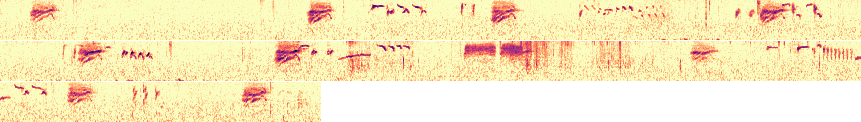

In [ ]:
query_rec = (user_recs
    .loc['20180805-60c3']  # BEWR
    .pipe(projection.slice_audio, 6.5)  # Re-denoise spectro
)
print(rec_str_line(query_rec))
display(rec_probs(query_rec, search)[:15].T)
plot_spectro_micro(query_rec, features, wrap=True,
    # audio=True,
    # limit_s=60,
)

 43.9  20170819-8661  2017-08-19T16:27:21  _UNK  4.7s  UNK_20170819_092720


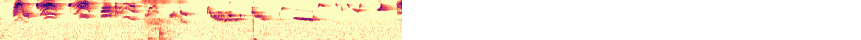

 45.0  20170514-94f6  2017-05-14T15:59:19  _UNK  127.8s  various (community garden by christopher playground)


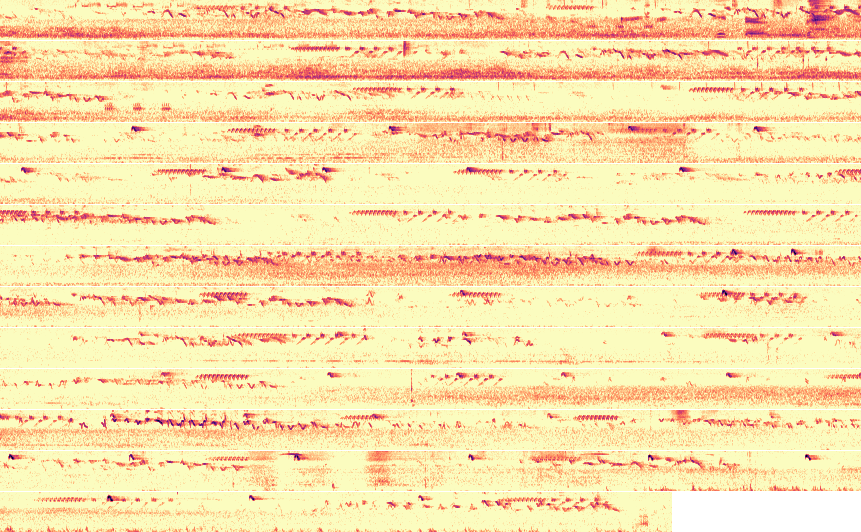

 45.7  20171007-602c  2017-10-07T15:20:39  BEWR  46.5s  BEWR Bewicks Wren (Coyote Hills parking lot)


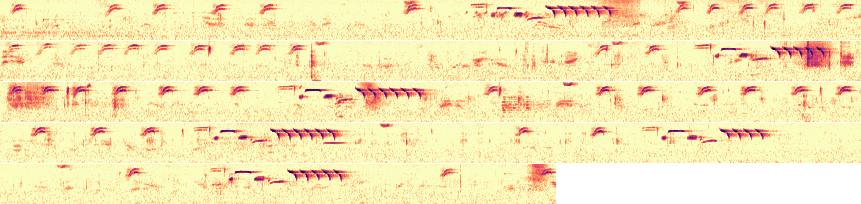

In [ ]:
for result in df_rows(
    rec_neighbors(projection, query_rec, user_recs)
    [:3]
):
    print(rec_str_line(result, ('dist', '%5.1f')))
    plot_spectro_micro(result, features,
        wrap=True,
        # audio=True,
    )

# Search by dist(probs)

## SPTO

In [ ]:
# Precompute df_cell_*
spto = (xc_recs
    .query("species == 'SPTO'")
    # [:50]  # Faster dev
    .pipe(df_assign_first,
        # Naming: don't clobber existing cols, else e.g. downstream can't re-thumbnail from .audio
        # Perf: until we have caching, it's too slow to precompute more than ~2 of these; caller must compute lazily
        #   - TODO Add caching (and progress=True -- see notes in viz.py)
        thumb=df_cell_spectros(plot_thumbs, features, thumb_s=2, scale=dict(h=13)),  # Slow (~15s)
        # thumb_full=df_cell_spectros(plot_thumbs, features, thumb_s=2),  # Slow (~15s)
        micro=df_cell_spectros(plot_spectros_micro, features, wrap_s=26, scale=dict(h=13)),  # Slower (~30s)
        # micro_full=df_cell_spectros(plot_spectros_wrap, features),  # Slowest (~90s)
        thumb2=df_cell_spectros(plot_thumbs, features, thumb_s=2, scale=dict(h=26)),  # Slow (?s)
        micro2=df_cell_spectros(plot_spectros_micro, features, wrap_s=13, scale=dict(h=26)),  # Slow (?s)
        play=df_cell_audios,  # Fast (~0s)
    )
)

In [ ]:
# Overview: quality counts
spto.quality.value_counts().sort_index()

A           234
B           198
C            70
D             8
E             2
no score      9
Name: quality, dtype: int64

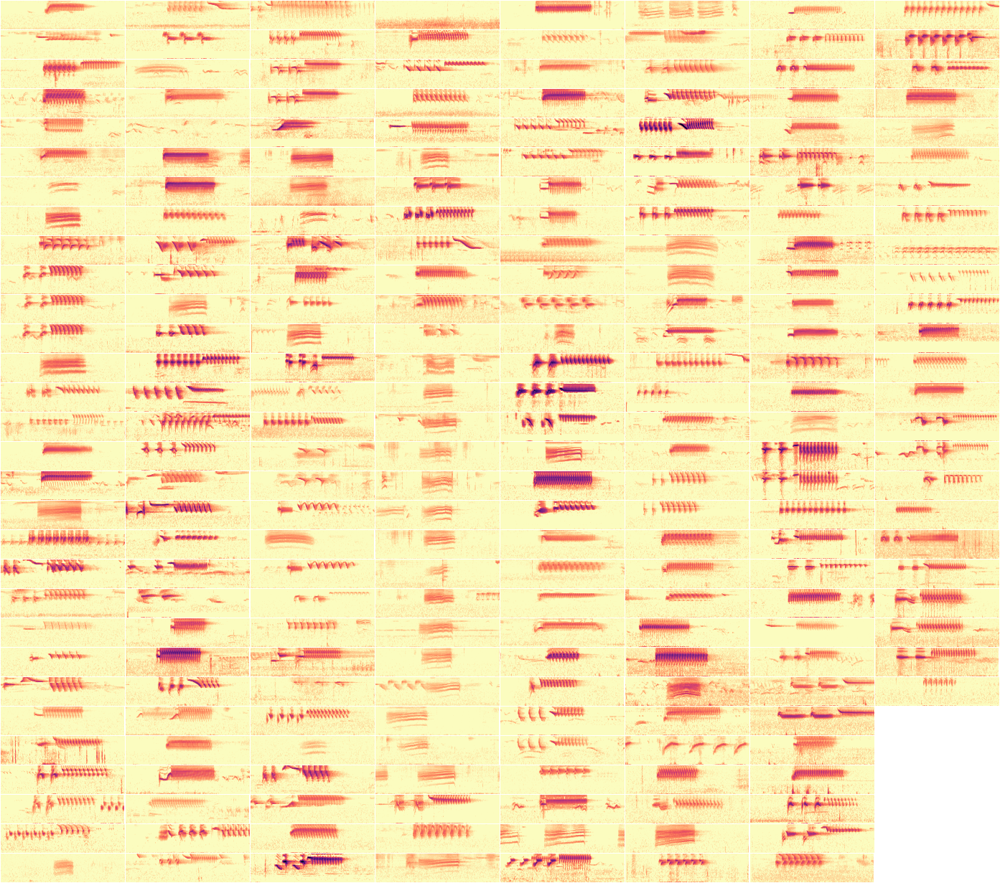

In [ ]:
# Overview: thumbs for quality=A
(spto
    .query("quality == 'A'")
    .sort_values('date', ascending=False)
    .pipe(plot_thumb_grid, features, thumb_s=2, cols=8)
)

In [ ]:
# Overview: (thumb, micro, ...) for quality=A
(spto
    .join(how='left', other=load_xc_handtype())
    .query("quality == 'A'")
    .pipe(df_col_color_d, handtype=mpl_cmap_concat('Set1', 'Set2'))
    # .pipe(sk.utils.shuffle, random_state=0)[:70]
    .sort_values(['lat', 'date'], ascending=[False, False])  # Order north->south
    [list(unique_everseen(['handtype', 'thumb', 'micro', *xc_eda_cols]))]
    # [:70]
)

,handtype,thumb,micro,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,
37389,coastal,,,SPTO,,A,26.1,song,"BC, Canada",49.3,-123.0,2009,07-27,7.0,7:00,by-nc-sa,Bob Planqué,50 m,None,None,['SWTH'],
159113,wheeze,,,SPTO,,A,78.3,call,"BC, Canada",48.9,-124.0,2012,08-02,13.0,13:16,by-nc-nd,Ian Cruickshank,m,None,no,[],"adult, agitated.\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone."
159915,wheeze?,,,SPTO,,A,85.1,call,"BC, Canada",48.8,-123.0,2013,02-09,12.0,12:15,by-nc-nd,Ian Cruickshank,m,None,no,[],
159823,wheeze,,,SPTO,,A,20.0,call,"BC, Canada",48.8,-124.0,2013,01-01,10.0,10:29,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
185532,variant,,,SPTO,oregonus,A,54.8,song,"British Columbia, Canada",48.8,-124.0,2014,07-05,20.0,20:30,by-nc-sa,Ian Cruickshank,0 m,None,None,[],interesting song type
325228,coastal,,,SPTO,,A,21.7,song,"British Columbia, Canada",48.6,-123.0,2016,04-07,17.0,17:00,by-nc-sa,James Bradley,60 m,yes,no,[],
158934,coastal,,,SPTO,,A,53.5,song,"BC, Canada",48.6,-123.0,2012,07-07,7.0,07:33,by-nc-nd,Ian Cruickshank,m,None,no,[],adult male\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
158943,coastal,,,SPTO,,A,84.4,song,"BC, Canada",48.6,-123.0,2012,07-07,8.0,08:11,by-nc-nd,Ian Cruickshank,m,None,no,[],adult male; good quality\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
182566,wheeze,,,SPTO,,A,41.0,"call, male","BC, Canada",48.5,-123.0,2014,06-18,10.0,10:30,by-nc-sa,Ian Cruickshank,120 m,yes,no,[],


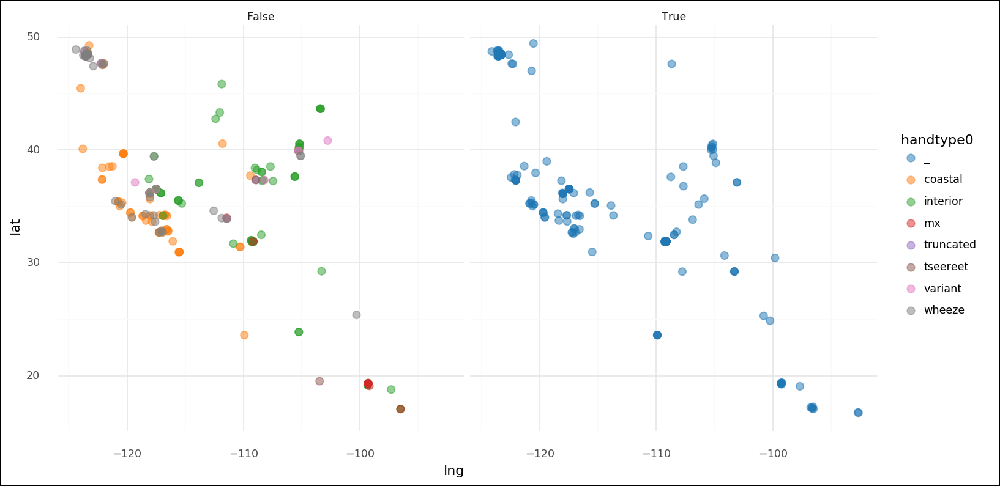

<ggplot: (-9223372035828738679)>

In [ ]:
# How well do handtypes 'coastal' vs. 'interior' separate by loc?
(spto
    .join(how='left', other=load_xc_handtype())
    .assign(handtype=lambda df: df.handtype.fillna('_'))
    .pipe(df_assign_first, handtype0=lambda df: df.handtype.map(lambda x: first(x or ['']).rstrip('?')))
    .pipe(df_reorder_cols, first=['handtype0', 'handtype'])
    .query("quality.isin(['A', 'B'])")
    .pipe(ggplot)
    + facet_wrap('handtype0 == "_"', ncol=2)
    + aes(x='lng', y='lat', color='handtype0')
    + geom_point(size=3, alpha=.5)
    + scale_color_cmap_d('tab10')
    + theme_minimal_white()
    + theme_figsize(aspect=1/1)
)

### Label: handtype

In [ ]:
# Save labels
(
    rec_neighbors(projection, query_rec, spto)
    .join(how='left', other=load_xc_handtype())
    .query("quality == 'A'")
    .pipe(xc_to_handtype_fwf_df)
)

[skip]

In [ ]:
# Make labels
(
    rec_neighbors(projection, spto.loc[159823], spto)
    .join(how='left', other=load_xc_handtype())
    .query("quality == 'A'")
    .reset_index()
    [0:][:20]
    .pipe(df_assign_first,
        micro=df_cell_spectros(plot_spectros_wrap, features, wrap_s=5, limit_s=60, scale=1.5),
    )
    [list(unique_everseen([
        'xc_id', 'handtype', 'thumb', 'micro', 'remarks_stack', 'state_stack', 'play',
        'place_only_stack', 'background_species_stack', *xc_eda_cols_stack,
    ]))]
)

[skip]

### Song (coastal)

,312024
species,SPTO
subspecies,
quality,A
duration_s,33.8
type,"alarm call, song"
state_stack,Cerro Alto Campground United States
lat,35.4
lng,-121.0
year,2016
month_day,04-11

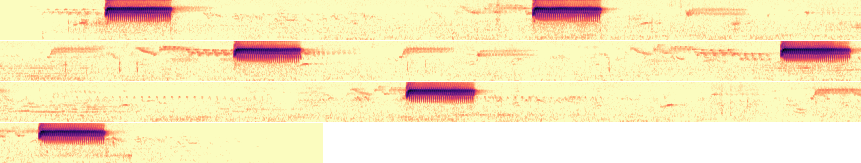

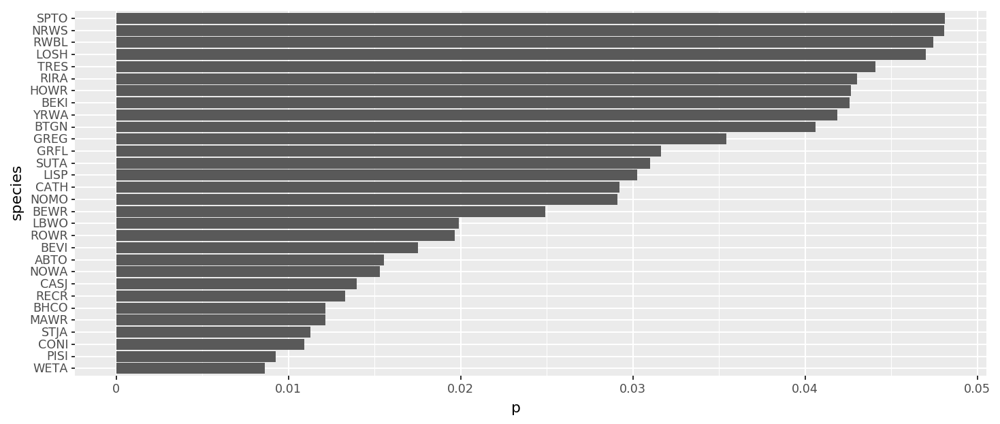

<ggplot: (1026047622)>

In [ ]:
query_rec = (spto
    [lambda df: df.index == 312024]
    .pipe(df_assign_first,
        thumb_big=df_cell_spectros(plot_thumbs, features, thumb_s=2),
        wrap=df_cell_spectros(plot_spectros_wrap, features),
        play=df_cell_audios,
    )
    .pipe(lambda df: first(df_rows(df)))
)
display(
    DF([query_rec])[[*xc_eda_cols_stack, 'thumb', 'wrap', 'play']].T,
    (
        rec_probs(query_rec, search)[:30]
        .pipe(df_ordered_cat, species=lambda df: (
            reversed(df.species)  # Sort by p (desc)
            # reversed(sorted_species(df.species))  # Sort by taxo
        ))
        .pipe(ggplot)
        + aes(x='species', y='p')
        # TODO Color by species_group
        #   - Hard part: globally consistent color assignment, even with subset of species_group's present
        #   - Solution! -- join and _keep_ the unused species_group categories, and then hide the legend
        + geom_col()
        + expand_limits(y=0)
        + coord_flip()
        + theme_figsize(aspect=1/2.5)
    ),
)

In [ ]:
def table_recs(
    recs,
    quality=['A'],
    limit=None,
    more_cols=[],
    size='big',  # 'big' | 'small'
):
    return (
        recs
        .join(how='left', other=load_xc_handtype())
        .pipe(df_col_color_d, handtype=mpl_cmap_concat('Set1', 'Set2', 'Set3'))
        [lambda df: df.quality.isin(quality)]
        [:limit]
        .pipe(lambda df: df if 'dist' not in df.columns else df_assign_first(df,
            dist_bar=lambda df: df.dist.map(lambda dist: text_bar(dist, max=df.dist.max(), norm=30, side='right')),
        ))
        .pipe(lambda df: df[[
            c
            for c in [
                'dist_bar', 'dist', 'handtype',
                *(['thumb2', 'micro2'] if size == 'big' else ['thumb', 'micro']),
                *more_cols,
                *xc_eda_cols,
            ]
            if c in df.columns
        ]])
    )

In [ ]:
table_recs(spto.sort_values('lat'))

,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,
274874,interior,,,SPTO,oaxacae,A,35.6,song,"Teotitlan de Valle , Mexico",17.1,-96.5,2015,03-30,6.0,06:27,by-nc-nd,Frank Lambert,1800 m,yes,no,[],
274872,mx,,,SPTO,oaxacae,A,14.1,song,"Teotitlan de Valle , Mexico",17.1,-96.5,2015,03-29,13.0,13:16,by-nc-nd,Frank Lambert,1800 m,yes,no,[],Same bird as XC274871
274873,interior?,,,SPTO,oaxacae,A,40.7,song,"Teotitlan de Valle , Mexico",17.1,-96.5,2015,03-29,13.0,13:18,by-nc-nd,Frank Lambert,1800 m,yes,yes,[],"Same bird as XC274871, XC274872"
261399,interior,,,SPTO,,A,87.6,song,"Veracruz, Mexico",18.8,-97.3,2015,07-18,11.0,11:00,by-nc-sa,Manuel Grosselet,2100 m,yes,no,[],"one bird responding to another in the far back, we can heard Trogon mexicanus, Catharus aurantiirostris"
353077,mx,,,SPTO,macronyx,A,38.0,song,"Distrito Federal, Mexico",19.1,-99.2,2017,01-27,9.0,09:30,by-nc-sa,Manuel Grosselet,3100 m,yes,yes,[],wiltronics mono amplified DR05
228177,interior,,,SPTO,,A,13.5,song,"Distrito F, Mexico",19.2,-99.3,2003,04-18,8.0,08:30,by-nc-nd,Peter Boesman,m,None,None,[],ID certainty 100%. (Archiv. tape 169 side A track 31 seq. A)
228176,interior,,,SPTO,,A,27.9,song,"Distrito F, Mexico",19.2,-99.3,2003,04-18,8.0,08:30,by-nc-nd,Peter Boesman,m,None,None,[],ID certainty 100%. (Archiv. tape 169 side A track 29 seq. A)
332625,interior,,,SPTO,,A,97.1,"male, song","Distrito Federal, Mexico",19.3,-99.3,2016,08-28,9.0,09:30,by-nc-sa,Esau Toaki Villarreal,3300 m,yes,no,['BBSO'],Microphone Parabolic 23 Inches Ornitronik and Recorder Tascam DR-40
168046,mx,,,SPTO,,A,18.7,song,"Mex DF entrance Desierto de los Leones, Mexico",19.3,-99.3,2014,02-23,8.0,08:00,by-nc-sa,Manuel Grosselet,2900 m,yes,no,[],


In [ ]:
# Found some coastals!
table_recs(rec_neighbors(projection, spto.loc[312024], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
312024,——————————————————————————————,0.0,coastal,,,SPTO,,A,33.8,"alarm call, song","Cerro Alto Campground, United States",35.4,-121.0,2016,04-11,10.0,10:54,by-nc-sa,Thomas G. Graves,340 m,no,no,['MOUQ'],"Low in shrubs, chapparal habitat, 8 feet from trail."
312025,———————■■■■■■■■■■■■■■■■■■■■■■■,36.2,coastal,,,SPTO,,A,87.5,"alarm call, song","Cerro Alto Campground, United States",35.4,-121.0,2016,04-11,10.0,10:57,by-nc-sa,Thomas G. Graves,340 m,no,no,"['MOUQ', 'STJA', 'ANHU', 'HOWR']","Low in shrubs, chapparal habitat, 8 feet from trail. Same individual as the one recorded at 10:54."
158943,——————■■■■■■■■■■■■■■■■■■■■■■■■,36.5,coastal,,,SPTO,,A,84.4,song,"BC, Canada",48.6,-123.0,2012,07-07,8.0,08:11,by-nc-nd,Ian Cruickshank,m,None,no,[],adult male; good quality\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
126629,——————■■■■■■■■■■■■■■■■■■■■■■■■,37.3,coastal,,,SPTO,megalonyx,A,12.7,song,"California, United States",34.3,-117.0,2000,07-09,nan,?,by-nc-sa,Richard E. Webster,1700 m,None,no,[],
408474,—————■■■■■■■■■■■■■■■■■■■■■■■■■,39.3,coastal,,,SPTO,megalonyx,A,10.8,song,"California, United States",34.2,-118.0,2015,05-23,8.0,08:45,by-nc-nd,Frank Lambert,600 m,yes,no,[],
368589,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,41.1,coastal,,,SPTO,,A,27.9,call,"Colorado, United States",40.0,-105.0,2017,03-27,12.0,12:03,by-nc-sa,Sue Riffe,1600 m,yes,no,"['NOFL', 'BCCH']",Male about 3 feet off the ground in riparian bramble. Just the 'tink tink tink' with no trill.
72245,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,42.2,coastal,,,SPTO,umbraticola,A,11.0,song,"Baja California, Mexico",31.0,-116.0,2001,06-16,17.0,1720,by-nc-nd,Richard E Webster,2400 m,None,None,[],individual No 2
126695,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,42.7,coastal,,,SPTO,falcinellus,A,57.5,song,"California, United States",35.7,-118.0,1995,06-23,nan,?,by-nc-sa,Richard E. Webster,2000 m,yes,no,"['BEWR', 'CASJ']",Individual No 2; hard coastal trill
206076,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,42.7,interior,,,SPTO,,A,53.6,song,"Colorado, United States",37.3,-107.0,2014,06-20,18.0,18:40,by-nc-sa,Eric DeFonso,2500 m,yes,no,['BGGN'],Bird singing from large gambel oak thicket just off main gravel road up to relay station.


In [ ]:
# Didn't find any wheezes -- did find noisy recs?!
table_recs(rec_neighbors(projection, spto.loc[127014], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
127014,——————————————————————————————,0.0,wheeze,,,SPTO,megalonyx,A,113.0,"call, song","San Diego County, United States",32.7,-117.0,2001,05-13,7.0,07:15,by-nc-sa,Richard E. Webster,100 m,None,no,"['American Yellow Warbler', 'YBCH', 'ATFL', 'COYE', 'SOSP', 'MODO']","2nd recording of this pair; calls, then many songs"
126980,———————■■■■■■■■■■■■■■■■■■■■■■■,53.2,interior,,,SPTO,montanus,A,222.0,song,"Inyo County, United States",36.5,-117.0,1998,05-22,19.0,19:15,by-nc-sa,Richard E. Webster,2000 m,None,no,"['SPTO', 'BHGR']",Switches song types;
126990,———————■■■■■■■■■■■■■■■■■■■■■■■,54.8,interior,,,SPTO,montanus,A,167.0,song,"Inyo County, United States",36.5,-117.0,1998,05-23,5.0,05:10,by-nc-sa,Richard E. Webster,2000 m,yes,no,"['PIJA', 'BHGR', 'MODO', 'SPTO']",counter-singing
126706,——————■■■■■■■■■■■■■■■■■■■■■■■■,56.1,interior,,,SPTO,falcinellus,A,79.6,"call, song","California, United States",36.2,-118.0,2000,06-16,19.0,19:05,by-nc-sa,Richard E. Webster,1400 m,None,no,['CATH'],interior song type; Individual No 3 recorded today
126986,—————■■■■■■■■■■■■■■■■■■■■■■■■■,59.8,coastal,,,SPTO,megalonyx,A,130.0,song,"California, United States",33.0,-117.0,1998,05-19,nan,?,by-nc-sa,Richard E. Webster,1500 m,yes,no,"['ACWO', 'NUWO', 'VGSW', 'MOCH', 'MODO']",
181397,————■■■■■■■■■■■■■■■■■■■■■■■■■■,62.3,coastal,,,SPTO,,A,53.7,song,"California, United States",40.1,-124.0,2014,05-17,7.0,07:30,by-nc-sa,Eric Cannizzaro,160 m,no,no,[],
126763,————■■■■■■■■■■■■■■■■■■■■■■■■■■,62.3,interior,,,SPTO,montanus,A,127.0,song,"Inyo County, United States",36.5,-117.0,1995,05-12,nan,?,by-nc-sa,Richard E. Webster,2200 m,yes,no,"['WOSJ', 'BHGR']",Individual No 2 recorded today; a rather short introductory section
205280,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,64.4,interior,,,SPTO,,A,531.0,song,"Colorado, United States",40.2,-105.0,2014,04-07,7.0,07:30,by-nc-sa,Eric DeFonso,1700 m,yes,no,['WEME'],"Extended song bout. Bird perched amid mountain mahogany 30 and then ~20m from mic. Two song types, which changeover at 2:40. Notable wind buffeting in middle 4 minutes. Wind noise below 100Hz filte..."
126705,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,65.0,"coastal,interior",,,SPTO,montanus,A,64.1,"call, song","Inyo County, United States",36.5,-117.0,1995,05-12,nan,?,by-nc-sa,Richard E. Webster,2200 m,None,no,"['PIJA', 'WOSJ']","Individual No 3 in the foreground; in retrospect, I'm not sure what was going on, with an odd song given by the foreground bird and a regular one in the background, then the one in the foreground i..."


In [ ]:
# Great wheeze example!
table_recs(rec_neighbors(projection, spto.loc[159823], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
159823,——————————————————————————————,0.0,wheeze,,,SPTO,,A,20.0,call,"BC, Canada",48.8,-124.0,2013,01-01,10.0,10:29,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
159721,———————————■■■■■■■■■■■■■■■■■■■,23.6,wheeze,,,SPTO,,A,8.11,call,"BC, Canada",48.3,-124.0,2012,10-05,8.0,08:13,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
159417,—————————■■■■■■■■■■■■■■■■■■■■■,26.1,wheeze,,,SPTO,,A,66.2,call,"BC, Canada",48.3,-124.0,2012,09-01,7.0,07:28,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
159140,———————■■■■■■■■■■■■■■■■■■■■■■■,28.3,wheeze,,,SPTO,,A,16.2,contact calls,"BC, Canada",48.5,-123.0,2012,08-05,7.0,07:49,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
33266,—————■■■■■■■■■■■■■■■■■■■■■■■■■,30.4,wheeze,,,SPTO,oregonus,A,44.0,Alarm call,"WA, United States",47.7,-122.0,2009,04-21,9.0,9:05,by-nc-nd,Tayler Brooks,5 m,None,None,"['SOSP', 'AMCR', 'BCCH']",
319145,—————■■■■■■■■■■■■■■■■■■■■■■■■■,30.6,coastal,,,SPTO,falcinellus,A,72.1,call,"California, United States",38.5,-122.0,2016,05-29,8.0,08:30,by-nc-sa,Jim Holmes,10 m,yes,no,[],
367065,—————■■■■■■■■■■■■■■■■■■■■■■■■■,30.7,wheeze,,,SPTO,,A,37.9,call,"California, United States",35.2,-121.0,2017,04-12,17.0,17:46,by-nc-sa,Thomas G. Graves,100 m,yes,no,[],"Same individual as the one I recorded at 17:45, still foraging, and then he flew away, listen for wing beats."
406591,————■■■■■■■■■■■■■■■■■■■■■■■■■■,31.8,wheeze,,,SPTO,megalonyx,A,67.8,call,"California, United States",33.7,-118.0,2018,03-18,17.0,17:50,by-nc-sa,Kat Avila,340 m,yes,no,"['AMCR', 'ACWO']","In or under berry-filled toyon shrub on Mesa Trail in an area with sagebrush, buckwheat, peppertrees, and pine trees. Cold and overcast weather."
159363,————■■■■■■■■■■■■■■■■■■■■■■■■■■,31.9,wheeze,,,SPTO,,A,97.6,call,"BC, Canada",48.5,-123.0,2012,08-26,6.0,06:45,by-nc-nd,Ian Cruickshank,m,None,no,[],adult birds at last\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.


In [ ]:
# Found wheezes!
table_recs(rec_neighbors(projection, spto.loc[182566], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
182566,——————————————————————————————,0.0,wheeze,,,SPTO,,A,41.0,"call, male","BC, Canada",48.5,-123.0,2014,06-18,10.0,10:30,by-nc-sa,Ian Cruickshank,120 m,yes,no,[],
159113,————————————■■■■■■■■■■■■■■■■■■,29.4,wheeze,,,SPTO,,A,78.3,call,"BC, Canada",48.9,-124.0,2012,08-02,13.0,13:16,by-nc-nd,Ian Cruickshank,m,None,no,[],"adult, agitated.\n\nRecorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone."
384076,—————————■■■■■■■■■■■■■■■■■■■■■,33.8,wheeze,,,SPTO,oregonus,A,20.4,call,"Washington, United States",47.4,-123.0,2017,08-22,9.0,09:00,by-nc-sa,Barry Edmonston,100 m,yes,no,[],The Spotted Towhee jumped into a nearby bush (about 6 meters away) while three of us were watching a group of about 16 Mountain Quails cross a nearby gravel road. The Towhee made several calls bef...
277025,—————■■■■■■■■■■■■■■■■■■■■■■■■■,41.1,wheeze,,,SPTO,,A,51.6,call,"Washington, United States",48.1,-123.0,2015,08-18,8.0,08:30,by-nc-sa,Greg Irving,40 m,yes,no,[],
219343,—————■■■■■■■■■■■■■■■■■■■■■■■■■,41.3,wheeze,,,SPTO,,A,73.8,call,"California, United States",35.5,-121.0,2015,03-08,16.0,16:11,by-nc-sa,Thomas G. Graves,40 m,yes,no,[],Calling from low shrub along trail.
159430,————■■■■■■■■■■■■■■■■■■■■■■■■■■,42.0,wheeze,,,SPTO,,A,66.6,mew calls,"BC, Canada",48.3,-124.0,2012,09-01,11.0,11:06,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
375917,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,43.4,wheeze,,,SPTO,,A,98.9,call,"Nevada, United States",39.4,-118.0,2017,06-10,7.0,07:30,by-nc-sa,Bobby Wilcox,2000 m,yes,no,"['BGGN', 'SPTO', 'BTYW']","Foraging and preening from a pinyon near large, dense riparian shrubs, about 10ft from me. Amplified and high pass filter with Audacity. Recorded on Olympus LS-P2."
89392,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,45.4,wheeze,,,SPTO,megalonyx,A,18.1,call,"CA, United States",34.0,-120.0,2011,10-28,7.0,07:30,by-nc-nd,Steve Hampton,45 m,None,None,[],
126708,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,46.1,coastal,,,SPTO,falcinellus,A,52.4,song,"California, United States",36.2,-118.0,1995,05-19,nan,?,by-nc-sa,Richard E. Webster,2400 m,yes,no,['OSFL'],Individual No 2 recorded on this date; a short coastal trill


In [ ]:
# 4/5 Seems like we found most of the mx's near the top, which there aren't many of
table_recs(rec_neighbors(projection, spto.loc[168046], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
168046,——————————————————————————————,0.0,mx,,,SPTO,,A,18.7,song,"Mex DF entrance Desierto de los Leones, Mexico",19.3,-99.3,2014,02-23,8.0,08:00,by-nc-sa,Manuel Grosselet,2900 m,yes,no,[],
353077,————————■■■■■■■■■■■■■■■■■■■■■■,56.2,mx,,,SPTO,macronyx,A,38.0,song,"Distrito Federal, Mexico",19.1,-99.2,2017,01-27,9.0,09:30,by-nc-sa,Manuel Grosselet,3100 m,yes,yes,[],wiltronics mono amplified DR05
182544,—————■■■■■■■■■■■■■■■■■■■■■■■■■,66.3,"variant,interior",,,SPTO,,A,35.8,song,"Colorado, United States",39.9,-105.0,2014,06-17,19.0,19:22,by-nc-sa,Ted Floyd,1800 m,yes,no,"['BBMA', 'LAZB', 'WEME']","This adult male Spotted Towhee sang two song types. In this recording, he switches from one song type (first four bouts) to a the second (fifth bout). The first song type (1-4 in this recording) is..."
413017,————■■■■■■■■■■■■■■■■■■■■■■■■■■,67.2,"coastal,tseereet",,,SPTO,,A,133.0,"5 types of calls, call, song","Botanical Gardens, United States",34.5,-120.0,2018,04-23,9.0,9:32,by-nc-sa,Thomas G. Graves,220 m,yes,no,"['AMCR', 'CAQU', 'WIWA', 'LEGO', 'selasphorus sp.']","Interesteing alternating song consisting of 4 different calls. Selasphorus hummingbird, Allen's or Rufous, in background."
112080,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,69.5,interior,,,SPTO,montanus,A,176.0,song,"Chiricahua Mountains, United States",31.9,-109.0,2012,07-22,8.0,08:51,by-nc-nd,Richard E Webster,2700 m,None,None,"['COFL', 'HETH', 'YEJU', 'HOWR']",
205921,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,69.8,interior,,,SPTO,,A,251.0,song,"Colorado, United States",37.3,-108.0,2014,06-02,19.0,19:37,by-nc-sa,Eric DeFonso,2300 m,yes,no,"['BGGN', 'DUFL', 'MODO']","Extended cut of song featuring two different types, with the switch occurring around 2:20. Bird within dense gambel oak stand. Clicking sounds are from cicadas."
376227,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,70.7,"coastal,interior",,,SPTO,,A,60.0,song,"Colorado, United States",39.9,-105.0,2017,06-18,5.0,05:07,by-nc-sa,Ted Floyd,1800 m,no,no,[],A Spotted Towhee going off along the Fowler Trail. This is the same individual as in XC376224 and XC376226.
76206,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,70.9,coastal,,,SPTO,oregonus,A,60.4,song,"Washington, United States",47.5,-122.0,2011,04-20,7.0,07:45,by-nc-nd,Andrew Spencer,430 m,None,None,[],natural vocalization
326476,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,71.0,mx,,,SPTO,macronyx,A,45.8,"plane, song","Mex DF entrance Desierto de los Leones, Mexico",19.3,-99.3,2016,07-09,9.0,09:30,by-nc-sa,Manuel Grosselet,2900 m,no,no,['GBWA'],wildtronics mono amplified DR05 tripod


In [ ]:
table_recs(rec_neighbors(projection, spto.loc[274874], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
274874,——————————————————————————————,0.0,interior,,,SPTO,oaxacae,A,35.6,song,"Teotitlan de Valle , Mexico",17.1,-96.5,2015,03-30,6.0,06:27,by-nc-nd,Frank Lambert,1800 m,yes,no,[],
131561,—————■■■■■■■■■■■■■■■■■■■■■■■■■,46.0,coastal,,,SPTO,,A,60.9,song,"California, United States",39.7,-120.0,2012,06-21,7.0,07:07,by-nc-sa,Eric DeFonso,1500 m,yes,no,"['OSFL', 'WBNU', 'MODO']","All recordings from 21 Jun 2012 were made with a 26"" Teilinga parabolic mic on loan from the ML (my first time using such a mic). Similar song type to XC131543, this one having no initial lead-in n..."
127029,————■■■■■■■■■■■■■■■■■■■■■■■■■■,48.1,coastal,,,SPTO,montanus,A,48.5,song,"Inyo County, United States",36.5,-117.0,2000,05-21,nan,?,by-nc-sa,Richard E. Webster,2000 m,yes,no,"['PLVI', 'LEGO']","Individual No 2 recorded today; it is giving just a hard trill as a song (more coastal in structure, but it is a hard, different trill from typical coastal song)"
126763,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,48.6,interior,,,SPTO,montanus,A,127.0,song,"Inyo County, United States",36.5,-117.0,1995,05-12,nan,?,by-nc-sa,Richard E. Webster,2200 m,yes,no,"['WOSJ', 'BHGR']",Individual No 2 recorded today; a rather short introductory section
376288,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,48.7,coastal,,,SPTO,,A,105.0,song,"California, United States",35.3,-120.0,2017,06-18,7.0,7:37,by-nc-sa,Thomas G. Graves,440 m,yes,no,"['ACWO', 'ATFL', 'CASJ']","Atypical song: usual introductory “burst note”, followed by relatively slow trill composed of 5 to 7 paired overlapping musical notes. (ME 62 Sennheiser, 24’ Roché Parabola, PMD 661 Marantz)"
126698,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,52.0,coastal,,,SPTO,montanus,A,73.1,song,"Inyo County, United States",36.5,-117.0,1995,06-24,nan,?,by-nc-sa,Richard E. Webster,1300 m,yes,no,"['BGGN', 'LAZB', 'HOFI']","a hard trill, rather coastal, with a terminal squeak after the first couple of songs; Grapevine Canyon"
320564,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,52.0,interior?,,,SPTO,,A,77.9,song,"Colorado, United States",37.6,-106.0,2016,05-31,4.0,04:55,by-nc-sa,Ted Floyd,2400 m,yes,no,[],"Note how the species switches from a vaguely Eastern Towhee-like song to a ""normal"" Spotted Towhee-like song. This bird is likely the same individual as in XC307976 and XC307981."
374110,—■■■■■■■■■■■■■■■■■■■■■■■■■■■■■,52.7,interior,,,SPTO,,A,153.0,"male, song","Colorado, United States",40.5,-105.0,2017,06-01,9.0,09:58,by-nc-sa,Matt Wistrand,2100 m,yes,no,[],
340723,—■■■■■■■■■■■■■■■■■■■■■■■■■■■■■,52.7,variant,,,SPTO,,A,38.9,Double Whistle,"Washington, United States",47.7,-122.0,2015,05-30,5.0,05:30,by-nc-sa,Bruce Lagerquist,20 m,yes,no,"['AMRO', 'COYE']",Bird perched on the top of a small deciduous tree at the of the forest


In [ ]:
table_recs(rec_neighbors(projection, spto.loc[126698], spto), limit=20)

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
126698,——————————————————————————————,0.0,coastal,,,SPTO,montanus,A,73.1,song,"Inyo County, United States",36.5,-117.0,1995,06-24,nan,?,by-nc-sa,Richard E. Webster,1300 m,yes,no,"['BGGN', 'LAZB', 'HOFI']","a hard trill, rather coastal, with a terminal squeak after the first couple of songs; Grapevine Canyon"
126638,————■■■■■■■■■■■■■■■■■■■■■■■■■■,43.7,variant,,,SPTO,megalonyx,A,26.8,song,"Inyo County, United States",36.5,-117.0,1995,06-24,17.0,17:00,by-nc-sa,Richard E. Webster,1300 m,yes,no,[],"Individual No 2 recorded here; an odd song type, perhaps not typical song"
126979,————■■■■■■■■■■■■■■■■■■■■■■■■■■,44.6,interior,,,SPTO,montanus,A,126.0,song,"Inyo County, United States",36.5,-117.0,1995,05-12,nan,?,by-nc-sa,Richard E. Webster,2000 m,None,no,"['MODO', 'BHGR', 'BEWR', 'CORA']","Switches song types; recorded ""near dawn"""
127029,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,45.3,coastal,,,SPTO,montanus,A,48.5,song,"Inyo County, United States",36.5,-117.0,2000,05-21,nan,?,by-nc-sa,Richard E. Webster,2000 m,yes,no,"['PLVI', 'LEGO']","Individual No 2 recorded today; it is giving just a hard trill as a song (more coastal in structure, but it is a hard, different trill from typical coastal song)"
376288,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,45.6,coastal,,,SPTO,,A,105.0,song,"California, United States",35.3,-120.0,2017,06-18,7.0,7:37,by-nc-sa,Thomas G. Graves,440 m,yes,no,"['ACWO', 'ATFL', 'CASJ']","Atypical song: usual introductory “burst note”, followed by relatively slow trill composed of 5 to 7 paired overlapping musical notes. (ME 62 Sennheiser, 24’ Roché Parabola, PMD 661 Marantz)"
127000,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,46.6,interior,,,SPTO,falcinellus,A,84.2,song,"California, United States",36.2,-118.0,1995,05-19,nan,?,by-nc-sa,Richard E. Webster,2400 m,yes,no,['FOSP'],unusual introductory phrase; an interior song type
367803,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,46.6,variant,,,SPTO,,A,181.0,song,"Colorado, United States",40.8,-103.0,2016,06-01,8.0,08:37,by-nc-sa,Eric DeFonso,1100 m,yes,no,"['RHWO', 'WEWP', 'WEKI', 'MODO', 'BAOR', 'SPTO']","Extended cut of somewhat atypical, unvarying song from bird along E sector road near gallery forest. Second towhee song audible about 2 minutes in."
205921,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,47.2,interior,,,SPTO,,A,251.0,song,"Colorado, United States",37.3,-108.0,2014,06-02,19.0,19:37,by-nc-sa,Eric DeFonso,2300 m,yes,no,"['BGGN', 'DUFL', 'MODO']","Extended cut of song featuring two different types, with the switch occurring around 2:20. Bird within dense gambel oak stand. Clicking sounds are from cicadas."
320564,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,47.9,interior?,,,SPTO,,A,77.9,song,"Colorado, United States",37.6,-106.0,2016,05-31,4.0,04:55,by-nc-sa,Ted Floyd,2400 m,yes,no,[],"Note how the species switches from a vaguely Eastern Towhee-like song to a ""normal"" Spotted Towhee-like song. This bird is likely the same individual as in XC307976 and XC307981."


20180429-dcf3  2018-04-29T16:35:13  SPTO  1.1s  SPTO spotted towhee song- kings rd+fe1bba74


,species,p
0,CHSP,0.025
1,BEWR,0.024
2,OATI,0.023
3,SAPH,0.022
4,DEJU,0.022
5,SPTO,0.022
6,PAGP,0.021
7,AMGO,0.021
8,WATA,0.021
9,SPSA,0.021


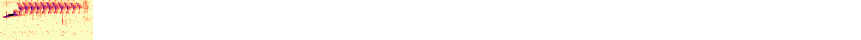

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
325379,———————■■■■■■■■■■■■■■■■■■■■■■■,36.8,coastal,,,SPTO,falcinellus,A,2.9,song,"California, United States",38.6,-121.0,2016,07-03,7.0,07:00,by-nc-sa,Jim Holmes,40 m,yes,no,[],
100251,———————■■■■■■■■■■■■■■■■■■■■■■■,37.2,coastal,,,SPTO,,A,18.5,Song,"Point Loma Nazarene University, United States",32.7,-117.0,2012,04-22,7.0,07:45AM,by-nc-nd,Trent R. Stanley,85 m,None,None,[],
325228,——————■■■■■■■■■■■■■■■■■■■■■■■■,39.0,coastal,,,SPTO,,A,21.7,song,"British Columbia, Canada",48.6,-123.0,2016,04-07,17.0,17:00,by-nc-sa,James Bradley,60 m,yes,no,[],
179496,——————■■■■■■■■■■■■■■■■■■■■■■■■,39.5,wheeze,,,SPTO,,A,32.7,"alarm call, call","Arizona, United States",33.9,-111.0,2014,05-23,12.0,12:08,by-nc-sa,Tim Marquardt,1700 m,yes,no,[],
159140,—————■■■■■■■■■■■■■■■■■■■■■■■■■,40.7,wheeze,,,SPTO,,A,16.2,contact calls,"BC, Canada",48.5,-123.0,2012,08-05,7.0,07:49,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
37389,————■■■■■■■■■■■■■■■■■■■■■■■■■■,41.3,coastal,,,SPTO,,A,26.1,song,"BC, Canada",49.3,-123.0,2009,07-27,7.0,7:00,by-nc-sa,Bob Planqué,50 m,None,None,['SWTH'],
228177,————■■■■■■■■■■■■■■■■■■■■■■■■■■,41.5,interior,,,SPTO,,A,13.5,song,"Distrito F, Mexico",19.2,-99.3,2003,04-18,8.0,08:30,by-nc-nd,Peter Boesman,m,None,None,[],ID certainty 100%. (Archiv. tape 169 side A track 31 seq. A)
159721,————■■■■■■■■■■■■■■■■■■■■■■■■■■,42.4,wheeze,,,SPTO,,A,8.11,call,"BC, Canada",48.3,-124.0,2012,10-05,8.0,08:13,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
126634,————■■■■■■■■■■■■■■■■■■■■■■■■■■,42.6,interior,,,SPTO,megalonyx,A,20.4,song,"San Bernardino Mountains, United States",34.2,-117.0,1998,06-16,17.0,17:30,by-nc-sa,Richard E. Webster,1450 m,yes,no,[],"A coastal/Pacific population, but an interior type introductory note."


In [ ]:
# YAY! THIS ONE WORKED!
#   - TODO Try different time slices
user_rec_spto_slow_clean = (user_recs
    .loc['20180429-dcf3']  # SPTO spotted towhee song- kings rd
    .pipe(projection.slice_spectro, 16.84, 17.92)
)
print(rec_str_line(user_rec_spto_slow_clean))
display(rec_probs(user_rec_spto_slow_clean, search)[:15])
plot_spectro_micro(user_rec_spto_slow_clean, features,
    # audio=True,
)
table_recs(rec_neighbors(projection, user_rec_spto_slow_clean, spto), limit=20)

20160923-0ac1  2016-09-23T19:03:47  _UNK  1.5s  caique purring+2f1f0a77


,species,p
0,GREG,0.034
1,CLNU,0.034
2,WISA,0.034
3,CORA,0.034
4,STJA,0.034
5,AMCR,0.034
6,NSWO,0.033
7,GBHE,0.033
8,SNEG,0.033
9,AMBI,0.033


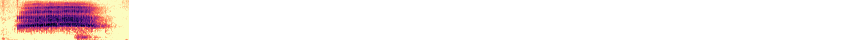

recordings/caique purring+2f1f0a77: 1 channels, 16 bit, sampled @ 22.05 kHz, 1.500s long

,dist_bar,dist,handtype,thumb2,micro2,species,subspecies,quality,duration_s,type,state,lat,lng,year,month_day,hour,time,license_type,recordist,elevation,bird_seen,playback_used,background_species,remarks
xc_id,,,,,,,,,,,,,,,,,,,,,,,,
320371,———————■■■■■■■■■■■■■■■■■■■■■■■,43.2,wheeze,,,SPTO,,A,61.9,call,"California, United States",34.2,-118.0,2016,06-05,20.0,20:14,by-nc-sa,Lance A. M. Benner,1300 m,no,no,[],"Recorded 14 minutes after sunset in dense chaparral on a south-facing slope. \n\nEquipment: Sony PCM-M10 recorder, Sennheiser ME62 microphone, and a Telinga 22 inch parabola.\nModifications to the fi..."
219343,———————■■■■■■■■■■■■■■■■■■■■■■■,43.8,wheeze,,,SPTO,,A,73.8,call,"California, United States",35.5,-121.0,2015,03-08,16.0,16:11,by-nc-sa,Thomas G. Graves,40 m,yes,no,[],Calling from low shrub along trail.
367065,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,50.6,wheeze,,,SPTO,,A,37.9,call,"California, United States",35.2,-121.0,2017,04-12,17.0,17:46,by-nc-sa,Thomas G. Graves,100 m,yes,no,[],"Same individual as the one I recorded at 17:45, still foraging, and then he flew away, listen for wing beats."
159430,———■■■■■■■■■■■■■■■■■■■■■■■■■■■,51.7,wheeze,,,SPTO,,A,66.6,mew calls,"BC, Canada",48.3,-124.0,2012,09-01,11.0,11:06,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
384076,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,53.0,wheeze,,,SPTO,oregonus,A,20.4,call,"Washington, United States",47.4,-123.0,2017,08-22,9.0,09:00,by-nc-sa,Barry Edmonston,100 m,yes,no,[],The Spotted Towhee jumped into a nearby bush (about 6 meters away) while three of us were watching a group of about 16 Mountain Quails cross a nearby gravel road. The Towhee made several calls bef...
182566,——■■■■■■■■■■■■■■■■■■■■■■■■■■■■,53.8,wheeze,,,SPTO,,A,41.0,"call, male","BC, Canada",48.5,-123.0,2014,06-18,10.0,10:30,by-nc-sa,Ian Cruickshank,120 m,yes,no,[],
406591,—■■■■■■■■■■■■■■■■■■■■■■■■■■■■■,54.3,wheeze,,,SPTO,megalonyx,A,67.8,call,"California, United States",33.7,-118.0,2018,03-18,17.0,17:50,by-nc-sa,Kat Avila,340 m,yes,no,"['AMCR', 'ACWO']","In or under berry-filled toyon shrub on Mesa Trail in an area with sagebrush, buckwheat, peppertrees, and pine trees. Cold and overcast weather."
160228,—■■■■■■■■■■■■■■■■■■■■■■■■■■■■■,54.6,wheeze,,,SPTO,,A,19.3,call,"BC, Canada",48.4,-124.0,2013,04-25,13.0,13:04,by-nc-nd,Ian Cruickshank,m,None,no,[],Recorded on a Marantz PMD661 recorder using a Sennheiser ME66 microphone.
89392,—■■■■■■■■■■■■■■■■■■■■■■■■■■■■■,54.8,wheeze,,,SPTO,megalonyx,A,18.1,call,"CA, United States",34.0,-120.0,2011,10-28,7.0,07:30,by-nc-nd,Steve Hampton,45 m,None,None,[],


In [ ]:
user_rec_the_turkey = (user_recs
    .loc['20160923-0ac1']
    .pipe(projection.slice_spectro, 12, 13.5)
)
print(rec_str_line(user_rec_the_turkey))
display(rec_probs(user_rec_the_turkey, search)[:12])
plot_spectro_wrap(user_rec_the_turkey, features,
    wrap_s=10,
    audio=True,
)
table_recs(rec_neighbors(projection, user_rec_the_turkey, spto), limit=20, size='big')

# TODO We are equipped!
- [x] Make a bunch of ergonomics for EDA and app UX exploration
- [x] Simulate sifting through SPTO recs
- [ ] Simulate sifting through top N species with top K recs per species
- [ ] Try more query_rec's! -- a SPTO mew, a SPTO tink, and then more species!

# [stale] TODO Got a baseline! Next, try with the pca spaces.
- [ ] (!) How well does ranking even need to work, given that many species won't have that many recs?
- [x] Plot the pca(2) circle (forget the query_rec, just plot in order around the circle, starting anywhere)
- [ ] Plot query_rec dists in pca(3), pca(4), etc.
- [ ] Think harder...
    - [x] Pull better models? (these aren't trained on much data)
    - [x] Train some l1 models? (maybe a rabbithole)
    - ...